# 4.0

### Lesson 21

In [3]:
import numpy as np
import scipy.stats
import pandas as pd

import altair as alt

import bootcamp_utils

## 21.1

In [11]:
type(np.arange(11.0)[0])

numpy.float64

In [12]:
type(np.linspace(0,10,11)[0])

numpy.float64

## 21.2

In [17]:
df = pd.read_csv('../data/c_elegans_egg_xa.csv', comment='#')
xa_high = df.loc[df['food']=='high', 'area (sq um)'].values
xa_low = df.loc[df['food']=='low', 'area (sq um)'].values

In [28]:
def xa_to_diameter(xa):
    """
    Convert an array of cross-sectional areas
    to diameters with commensurate units.
    """
    
    # Compute diameter from area
    diameter = np.sqrt(np.multiply((4/np.pi),xa))
    
    return diameter

In [29]:
xas = [1 ,2 ,3 ,4]
xa_to_diameter(xas)

array([1.12837917, 1.59576912, 1.95441005, 2.25675833])

## 21.3

In [30]:
A = np.array([[6.7, 1.3, 0.6, 0.7],
              [0.1, 5.5, 0.4, 2.4],
              [1.1, 0.8, 4.5, 1.7],
              [0.0, 1.5, 3.4, 7.5]])

b = np.array([1.1, 2.3, 3.3, 3.9])

In [32]:
A[0]

array([6.7, 1.3, 0.6, 0.7])

In [42]:
A[:,(1,2)]

array([[1.3, 0.6],
       [5.5, 0.4],
       [0.8, 4.5],
       [1.5, 3.4]])

In [45]:
A[A>2]

array([6.7, 5.5, 2.4, 4.5, 3.4, 7.5])

In [47]:
np.diag(A)

array([6.7, 5.5, 4.5, 7.5])

In [49]:
x = np.linalg.solve(A,b)

In [51]:
np.dot(A,x)

array([1.1, 2.3, 3.3, 3.9])

In [52]:
np.transpose(A)

array([[6.7, 0.1, 1.1, 0. ],
       [1.3, 5.5, 0.8, 1.5],
       [0.6, 0.4, 4.5, 3.4],
       [0.7, 2.4, 1.7, 7.5]])

In [53]:
np.linalg.inv(A)

array([[ 0.15267508, -0.03365026, -0.01778   ,  0.00054854],
       [-0.00906001,  0.19788853,  0.03719385, -0.07090934],
       [-0.04391535, -0.0144834 ,  0.26880108, -0.05219479],
       [ 0.02172029, -0.0330119 , -0.12929526,  0.17117684]])

In [54]:
B = np.ravel(A)

In [57]:
np.reshape(B,(4,4))

array([[6.7, 1.3, 0.6, 0.7],
       [0.1, 5.5, 0.4, 2.4],
       [1.1, 0.8, 4.5, 1.7],
       [0. , 1.5, 3.4, 7.5]])

In [94]:
# Make smooth x-values
x = np.linspace(1600, 2500, 400)

# Compute theoretical Normal distribution for low food condition
cdf_theor_low = scipy.stats.norm.cdf(x, loc=np.mean(xa_low), scale=np.std(xa_low))

# Compute theoretical Normal distribution for high food condition
cdf_theor_high = scipy.stats.norm.cdf(x, loc=np.mean(xa_high), scale=np.std(xa_high))

In [95]:
empty_food_array = np.empty(len(x))

In [117]:
df_bs = pd.DataFrame(data={'area (sq um)': np.concatenate((x,x)),
                           'ecdf': np.concatenate((cdf_theor_low,cdf_theor_high)),
                           'food': np.concatenate((['low theoretical' for i in range(len(x))],
                                                   ['high theoretical' for i in range(len(x))]))})

In [156]:
bs_sample_high = [np.random.choice(xa_high, replace=True, size=len(xa_high))for i in range(100)]
bs_sample_low = [np.random.choice(xa_low, replace=True, size=len(xa_low))for i in range(100)]

In [118]:
df_bs.head()

,area (sq um),ecdf,food
0,1600.000000,0.000384,low theoretical
1,1602.255639,0.000406,low theoretical
2,1604.511278,0.000429,low theoretical
3,1606.766917,0.000452,low theoretical
4,1609.022556,0.000478,low theoretical


In [180]:
def ecdf_y(data):
    """Give y-values of an ECDF for an unsorted column in a data frame.
    
    Parameters
    ----------
    data : Pandas Series
        Series (or column of a DataFrame) from which to generate ECDF
        values

    Returns
    -------
    output : Pandas Series
        Corresponding y-values for an ECDF when plotted with dots.

    Notes
    -----
    .. This only works for plotting an ECDF with points, not for formal
       ECDFs
    
    """
    
    if type(data) == 'pandas.core.series.Series':
        data.rank(method='first') / len(data)
    else:
        return scipy.stats.rankdata(data) / len(data)

In [181]:
df['percent correct ecdf_y grouped by food'] = (
                        df.groupby('food').transform(ecdf_y))

In [183]:
#bs_sample_high_ecdf = [ecdf_y(boot_sample) for i,boot_sample in enumerate(bs_sample_high)]
#bs_sample_low_ecdf = [ecdf_y(boot_sample) for i,boot_sample in enumerate(bs_sample_low)]

In [193]:
bs_sample_high_ecdf = [pd.DataFrame(data={'area (sq um)': boot_sample, 
                                          'percent correct ecdf_y grouped by food': ecdf_y(boot_sample),
                                          'food':['high' for i in range(len(boot_sample))]})
                        for i,boot_sample in enumerate(bs_sample_high)]

bs_sample_low_ecdf = [pd.DataFrame(data={'area (sq um)': boot_sample, 
                                         'percent correct ecdf_y grouped by food': ecdf_y(boot_sample),
                                         'food':['low' for i in range(len(boot_sample))]})
                        for i,boot_sample in enumerate(bs_sample_low)]

In [194]:
bs_sample_high_ecdf[5].head()

,area (sq um),percent correct ecdf_y grouped by food,food
0,1833,0.767442,high
1,1749,0.500000,high
2,1882,0.895349,high
3,1642,0.058140,high
4,1661,0.139535,high


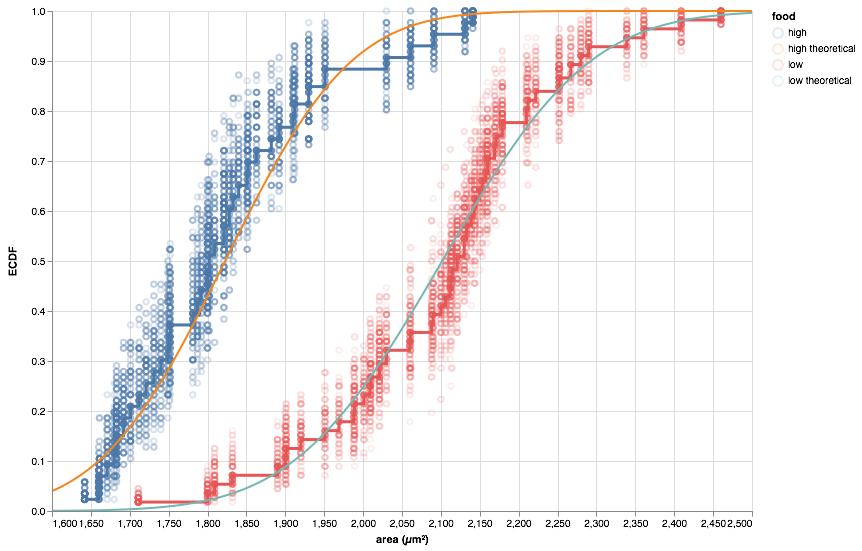

In [229]:
p = []

for i in range(100):
    p.append(alt.Chart(bs_sample_high_ecdf[i],
    height=500,
    width=700     
    ).mark_point(opacity=0.2
    ).encode(
        x=alt.X('area (sq um):Q', title='area (µm²)'),
        y=alt.Y('percent correct ecdf_y grouped by food:Q', title='ECDF'),
        order=alt.Order('percent correct ecdf_y grouped by food:Q', sort='ascending'),
        color='food'))
    
    p.append(alt.Chart(bs_sample_low_ecdf[i],
    height=500,
    width=700     
    ).mark_point(opacity=0.1
    ).encode(
        x=alt.X('area (sq um):Q', title='area (µm²)'),
        y=alt.Y('percent correct ecdf_y grouped by food:Q', title='ECDF'),
        order=alt.Order('percent correct ecdf_y grouped by food:Q', sort='ascending'),
        color='food'))
    
p.append(alt.Chart(df,
    height=500,
    width=700     
    ).mark_line(interpolate='step-after',
                strokeWidth=3
    ).encode(
        x=alt.X('area (sq um):Q', title='area (µm²)'),
        y=alt.Y('percent correct ecdf_y grouped by food:Q', title='ECDF'),
        order=alt.Order('percent correct ecdf_y grouped by food:Q', sort='ascending'),
        color='food'))

p.append(alt.Chart(df,
    height=500,
    width=700     
    ).mark_point(
    ).encode(
        x=alt.X('area (sq um):Q', title='area (µm²)'),
        y=alt.Y('percent correct ecdf_y grouped by food:Q', title='ECDF'),
        order=alt.Order('percent correct ecdf_y grouped by food:Q', sort='ascending'),
        color='food'))

p.append(alt.Chart(df_bs,
    ).mark_line(
    ).encode(
        x=alt.X('area (sq um):Q', title='area (µm²)', scale=alt.Scale(zero=False)),
        y=alt.Y('ecdf:Q', title='ECDF'),
        color='food'))

p_final = p[0]

for i in range(1, len(p)):
    p_final += p[i]
p_final

In [214]:
bs_samples = np.array([np.random.normal(np.mean(xa_high), np.std(xa_high), size=len(xa_high))
                  for _ in range(250)])
bs_samples = np.sort(bs_samples, axis=1)
df_plot = pd.DataFrame(data=bs_samples.T, columns=np.arange(250))
df_plot['ECDF'] = np.arange(1, len(xa_high)+1) / len(xa_high)

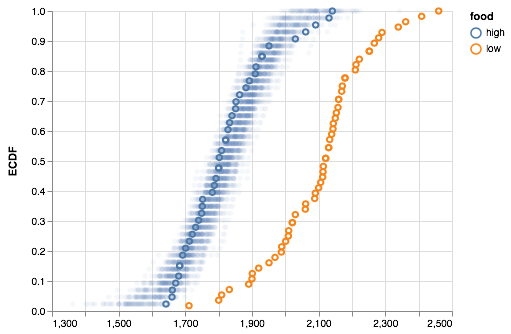

In [220]:
charts = tuple([alt.Chart(df_plot
    ).mark_point(
        opacity=0.05,
        filled=True
    ).encode(
        x=alt.X(f'{i}:Q', title=None, scale=alt.Scale(zero=False)),
        y='ECDF:Q'
    )  for i in range(100)])

data_ecdf = alt.Chart(df,   
    ).mark_point(
        color='tomato',
        opacity=1
    ).encode(
        x=alt.X('area (sq um):Q', title=None),
        y=alt.Y('percent correct ecdf_y grouped by food:Q', title='ECDF'),
        color='food')

alt.layer(*(charts + (data_ecdf,)))